In [1]:
import pandas as pd
import numpy as np
from pandas.tseries.offsets import MonthEnd
import calendar

In [2]:
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.compose import ColumnTransformer
from sklearn.metrics import classification_report, roc_auc_score, confusion_matrix
from imblearn.pipeline import Pipeline as ImbPipeline
from sklearn.preprocessing import FunctionTransformer
from imblearn.over_sampling import SMOTE
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt

In [ ]:
# Import data
file_path = 'Data_OC\df1.parquet'.parquet'
df = pd.read_parquet(file_path, engine='pyarrow')
pd.set_option('display.max_columns', None)

#print(df.columns.tolist())

In [4]:
# Import metadata
file_path = 'Data_OC\metadati_progetti_tracciato_esteso.xlsx'
meta = pd.read_excel(file_path)

In [5]:
meta1 = meta.iloc[:,:2]
meta1['SEZIONE'].value_counts()

SEZIONE
Finanziaria              55
Tempi                    35
Programmazione           26
Indicatori               21
Soggetti                 20
Altre classificazioni    14
Territorio                9
Anagrafica                5
Avanzamento               5
Procedura                 4
Flag                      4
Aggiornamento             1
Name: count, dtype: int64

In [6]:
#df.head()

### come esemplificazione iniziale iniziamo a selezionare solo: 
- Fonte_Calc = FS1420_FESR e definiamo df1
- the original df is too large to import in github so we restrict to FS1420_FESR category

df1 = df[df['Fonte_Calc']=='FS1420_FESR']

df1.to_parquet('Data_OC\df1.parquet', engine='pyarrow', index=False)

In [10]:
#df1.describe()

In [14]:
# code that drop the date that we dont need in the first analysis and correct the data not correct in the file setting the right
#format

df2 = df1.copy()

# Identify and drop columns to drop that contain 'data' (case-insensitive)
data_columns_drop = [col for col in df2.columns if 'data' in col]
df2 = df2.drop(columns=data_columns_drop)

# Identify columns to keep that contain 'DATA' (case-sensitive)
data_columns = [col for col in df2.columns if 'DATA' in col]

df2[data_columns] = df2[data_columns].fillna(0).astype(int)

# Correct invalid dates
for col in df2[data_columns].columns:
    corrected_dates = []
    for date in df2[col]:
        # Ensure date is a string in YYYYMMDD format
        date_str = str(date).zfill(8)
        year = int(date_str[:4])  # Extract year
        month = int(date_str[4:6])  # Extract month
        day = int(date_str[6:])  # Extract day

        # Get the last valid day of the month
        try:
            last_day = calendar.monthrange(year, month)[1]
        except ValueError:
            # Handle invalid months (e.g., month > 12)
            last_day = 0

        # Adjust the day if it exceeds the valid range
        if day > last_day or day == 0:
            day = last_day

        # Construct the corrected date
        corrected_date = f"{year:04d}{month:02d}{day:02d}"
        corrected_dates.append(corrected_date)

    # Update the column with corrected dates
    df2[col] = corrected_dates

# Convert the corrected columns to datetime
for col in df2[data_columns].columns:
    df2[col] = pd.to_datetime(df2[col], format='%Y%m%d', errors='coerce')

# Display the corrected DataFrame
df2.head()


,cod_locale_progetto,cup,oc_titolo_progetto,oc_sintesi_progetto,oc_link,OC_COD_CICLO,OC_DESCR_CICLO,OC_COD_TEMA_SINTETICO,OC_TEMA_SINTETICO,COD_GRANDE_PROGETTO,DESCRIZIONE_GRANDE_PROGETTO,OC_COD_FONTE,OC_DESCR_FONTE,FONDO_COMUNITARIO,OC_CODICE_PROGRAMMA,OC_DESCRIZIONE_PROGRAMMA,COD_OB_TEMATICO,DESCR_OB_TEMATICO,COD_PRIORITA_INVEST,DESCR_PRIORITA_INVEST,OC_COD_CATEGORIA_SPESA,OC_DESCR_CATEGORIA_SPESA,OC_ARTICOLAZIONE_PROGRAMMA,OC_SUBARTICOLAZIONE_PROGRAMMA,OC_COD_ARTICOLAZ_PROGRAMMA,OC_DESCR_ARTICOLAZ_PROGRAMMA,OC_COD_SUBARTICOLAZ_PROGRAMMA,OC_DESCR_SUBARTICOLAZ_PROGRAMMA,COD_STRUMENTO,DESCR_STRUMENTO,DESCR_TIPO_STRUMENTO,CUP_COD_NATURA,CUP_DESCR_NATURA,CUP_COD_TIPOLOGIA,CUP_DESCR_TIPOLOGIA,CUP_COD_SETTORE,CUP_DESCR_SETTORE,CUP_COD_SOTTOSETTORE,CUP_DESCR_SOTTOSETTORE,CUP_COD_CATEGORIA,CUP_DESCR_CATEGORIA,COD_ATECO,DESCRIZIONE_ATECO,OC_COD_TIPO_AIUTO,OC_DESCR_TIPO_AIUTO,COD_REGIONE,DEN_REGIONE,COD_PROVINCIA,DEN_PROVINCIA,COD_COMUNE,DEN_COMUNE,OC_MACROAREA,OC_COD_SLL,OC_DENOMINAZIONE_SLL,FINANZ_UE,FINANZ_UE_FESR,FINANZ_UE_FSE,FINANZ_UE_FEASR,FINANZ_UE_FEAMP,FINANZ_UE_IOG,FINANZ_STATO_FONDO_DI_ROTAZIONE,FINANZ_STATO_FSC,FINANZ_STATO_PAC,FINANZ_STATO_COMPLETAMENTI,FINANZ_STATO_ALTRI_PROVVEDIMENTI,FINANZ_REGIONE,FINANZ_PROVINCIA,FINANZ_COMUNE,FINANZ_RISORSE_LIBERATE,FINANZ_ALTRO_PUBBLICO,FINANZ_STATO_ESTERO,FINANZ_PRIVATO,FINANZ_DA_REPERIRE,FINANZ_TOTALE_PUBBLICO,ECONOMIE_TOTALI,ECONOMIE_TOTALI_PUBBLICHE,OC_FINANZ_UE_NETTO,OC_FINANZ_UE_FESR_NETTO,OC_FINANZ_UE_FSE_NETTO,OC_FINANZ_UE_FEASR_NETTO,OC_FINANZ_UE_FEAMP_NETTO,OC_FINANZ_UE_IOG_NETTO,OC_FINANZ_Stato_Fondo_Rot_NETTO,OC_FINANZ_Stato_FSC_NETTO,OC_FINANZ_Stato_PAC_NETTO,OC_FINANZ_Stato_compl_NETTO,OC_FINANZ_Stato_altri_prov_NETTO,OC_FINANZ_Regione_NETTO,OC_FINANZ_Provincia_NETTO,OC_FINANZ_Comune_NETTO,OC_FINANZ_Risorse_liberate_NETTO,OC_FINANZ_Altro_pubblico_NETTO,OC_FINANZ_Stato_estero_NETTO,OC_FINANZ_Privato_NETTO,OC_FINANZ_TOT_PUB_NETTO,OC_COSTO_COESIONE,IMPEGNI,OC_IMPEGNI_GIURID_VINCOLANTI,OC_IMPEGNI_TRASFERIMENTI,OC_IMPEGNI_COESIONE,TOT_PAGAMENTI,OC_TOT_PAGAMENTI_BENEFICIARI,OC_TOT_PAGAMENTI_TRASFERIMENTI,COSTO_REALIZZATO,COSTO_RENDICONTABILE_UE,OC_TOT_PAGAMENTI_RENDICONTAB_UE,OC_TOT_PAGAMENTI_FSC,OC_TOT_PAGAMENTI_PAC,OC_PAGAMENTI_COESIONE,OC_DATA_INIZIO_PROGETTO,OC_DATA_FINE_PROGETTO_PREVISTA,OC_DATA_FINE_PROGETTO_EFFETTIVA,OC_STATO_FINANZIARIO,OC_STATO_PROGETTO,OC_STATO_PROCEDURALE,OC_COD_FASE_CORRENTE,OC_DESCR_FASE_CORRENTE,COD_PROCED_ATTIVAZIONE,DESCR_PROCED_ATTIVAZIONE,COD_TIPO_PROCED_ATTIVAZIONE,DESCR_TIPO_PROCED_ATTIVAZIONE,OC_CODFISC_PROGRAMMATORE,OC_DENOM_PROGRAMMATORE,OC_COD_FORMA_GIU_PROGRAMMATORE,OC_DESCR_FORMA_GIU_PROGRAMMATORE,OC_TOTALE_PROGRAMMATORI,OC_CODFISC_ATTUATORE,OC_DENOM_ATTUATORE,OC_COD_FORMA_GIU_ATTUATORE,OC_DESCR_FORMA_GIU_ATTUATORE,OC_TOTALE_ATTUATORI,OC_CODFISC_BENEFICIARIO,OC_DENOM_BENEFICIARIO,OC_COD_FORMA_GIU_BENEFICIARIO,OC_DESCR_FORMA_GIU_BENEFICIARIO,OC_TOTALE_BENEFICIARI,OC_CODFISC_REALIZZATORE,OC_DENOM_REALIZZATORE,OC_COD_FORMA_GIU_REALIZZATORE,OC_DESCR_FORMA_GIU_REALIZZATORE,OC_TOTALE_REALIZZATORI,OC_TOTALE_INDICATORI,COD_INDICATORE_1,DESCR_INDICATORE_1,UNITA_MISURA_INDICATORE_1,PROGRAMMATO_INDICATORE_1,REALIZZATO_INDICATORE_1,COD_INDICATORE_2,DESCR_INDICATORE_2,UNITA_MISURA_INDICATORE_2,PROGRAMMATO_INDICATORE_2,REALIZZATO_INDICATORE_2,COD_INDICATORE_3,DESCR_INDICATORE_3,UNITA_MISURA_INDICATORE_3,PROGRAMMATO_INDICATORE_3,REALIZZATO_INDICATORE_3,COD_INDICATORE_4,DESCR_INDICATORE_4,UNITA_MISURA_INDICATORE_4,PROGRAMMATO_INDICATORE_4,REALIZZATO_INDICATORE_4,OC_FLAG_REGIONE_UNICA,OC_FLAG_VISUALIZZAZIONE,OC_FLAG_PAC,DATA_AGGIORNAMENTO,OC_FLAG_CUP,Fonte_Calc
24937,11FR103176,D59F20000220007,INFORMATIZZAZIONE E POTENZIAMENTO DEI PROCESSI,LA SOCIETÃ INTENDE AGGIORNARE IL PROPRIO SIST...,www.opencoesione.gov.it/progetti/11fr103176,2.0,Ciclo di programmazione 2014-2020,01,Ricerca e innovazione,None,None,FS1420,Fondi Strutturali relativi alla programmazione...,FESR,2014IT16RFOP009,POR FESR FRIULI-VENEZIA GIULIA,01,"Rafforzare la ricerca, lo sviluppo 

In [15]:
# drop columns if nan is > 70%

# Calculate the percentage of NaN or null values for each column in df2
nan_percentage = (df2.isnull().sum() / len(df2)) * 100

# Identify columns where the percentage of NaN is greater than 70%
columns_to_drop = nan_percentage[nan_percentage > 40].index

# Drop these columns from the DataFrame
df2 = df2.drop(columns=columns_to_drop)

In [16]:
# Indicatore_2 contiene ancora 14% di Nan ma non assume molta rilevanza in prima approssimazione per l'obiettivo quindi lo droppiamo: 

df2 = df2.drop(columns=df.columns[df.columns.str.contains('INDICATORE_2')])

In [17]:
# ci sono record che non hanno data fine effettiva, in questo caso inseriamo 31.12.2999 in modo fittizio ad indicare che non è terminato

df2['OC_DATA_FINE_PROGETTO_EFFETTIVA'] = df2['OC_DATA_FINE_PROGETTO_EFFETTIVA'].replace(['null', None, pd.NaT], '31.12.2099')
df2['OC_DATA_FINE_PROGETTO_EFFETTIVA'] = pd.to_datetime(df2['OC_DATA_FINE_PROGETTO_EFFETTIVA'], dayfirst=True)

In [18]:
# a questo punto i restanti elimino i recordi essendo sotto il 6%

columns_with_nan = df2.columns[df2.isnull().any()]

df2 = df2.dropna(subset=columns_with_nan).reset_index(drop=True)

In [19]:
# i residui che restano al 25% al momento eliminiamo colonne sono 2 relative al fondo di rotazione: 

# Calculate the percentage of NaN or null values for each column in df2
nan_percentage = (df2.isnull().sum() / len(df2)) * 100

# Identify columns where the percentage of NaN is greater than 70%
columns_to_drop = nan_percentage[nan_percentage > 25].index

# Drop these columns from the DataFrame
df2 = df2.drop(columns=columns_to_drop)

In [20]:
# Calculate the percentage of NaN or null values for each column in df2
nan_percentage = (df2.isnull().sum() / len(df2)) * 100

# Convert to a DataFrame for better readability
nan_percentage_df = nan_percentage.reset_index()
nan_percentage_df.columns = ['Column', 'Percentage of NaN']

# Sort the DataFrame by percentage in descending order for better visualization
nan_percentage_df = nan_percentage_df.sort_values(by='Percentage of NaN', ascending=False)

# Display the results using pandas for full output
print(nan_percentage_df.to_string(index=False))

                          Column  Percentage of NaN
             cod_locale_progetto                0.0
    OC_TOT_PAGAMENTI_BENEFICIARI                0.0
            OC_STATO_FINANZIARIO                0.0
 OC_DATA_FINE_PROGETTO_EFFETTIVA                0.0
  OC_DATA_FINE_PROGETTO_PREVISTA                0.0
         OC_DATA_INIZIO_PROGETTO                0.0
           OC_PAGAMENTI_COESIONE                0.0
            OC_TOT_PAGAMENTI_PAC                0.0
            OC_TOT_PAGAMENTI_FSC                0.0
 OC_TOT_PAGAMENTI_RENDICONTAB_UE                0.0
         COSTO_RENDICONTABILE_UE                0.0
                COSTO_REALIZZATO                0.0
  OC_TOT_PAGAMENTI_TRASFERIMENTI                0.0
                   TOT_PAGAMENTI                0.0
          FINANZ_TOTALE_PUBBLICO                0.0
             OC_IMPEGNI_COESIONE                0.0
    OC_IMPEGNI_GIURID_VINCOLANTI                0.0
                         IMPEGNI                0.0
            

In [21]:
df_lav=df2.copy()

In [22]:
df_lav.to_csv('data_output/df_lav.csv')

# Apply analitical classification:

define delay and Perc_contrib_nok to take out a criterio to classify.

- delay - to verify the amount of delay in days
- Perc_contrib_nok -- to verify the percentage of value not as expenses.

* At the start we tought to use some info visualized below, but we found not coherent info between them...so we decided to not use them.

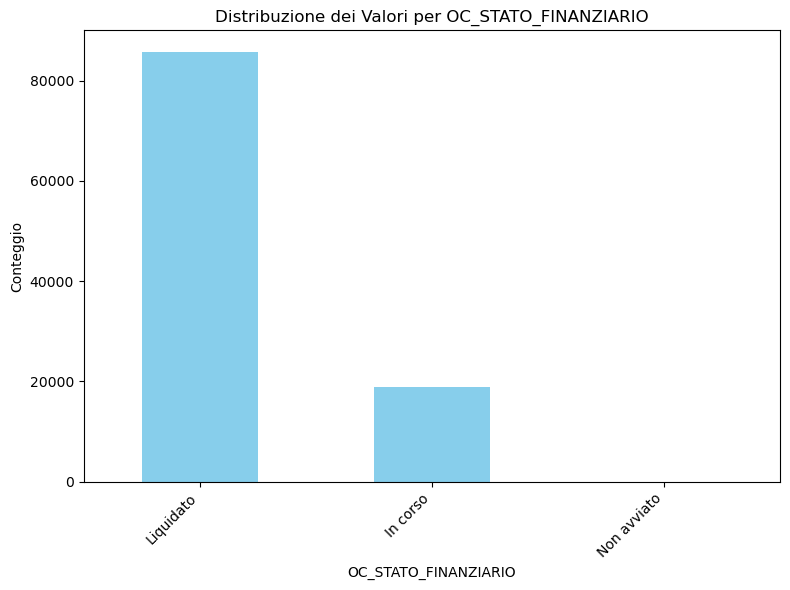

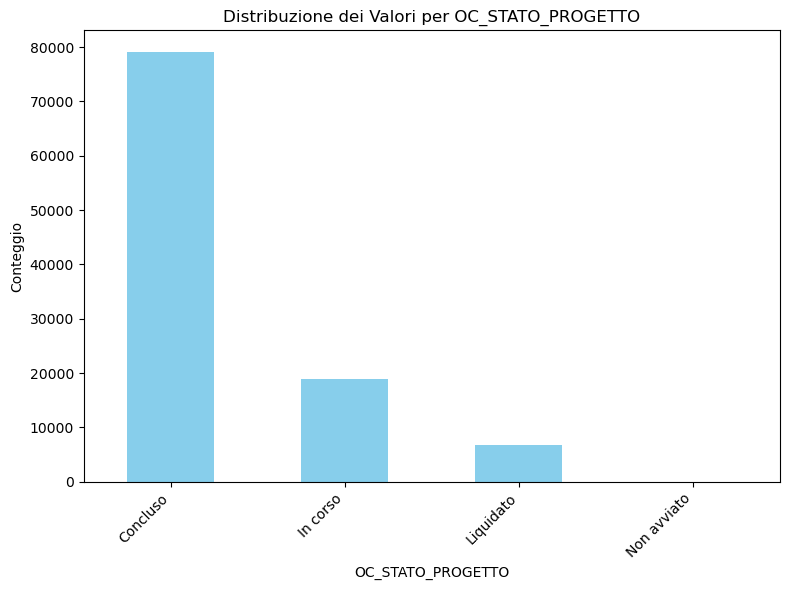

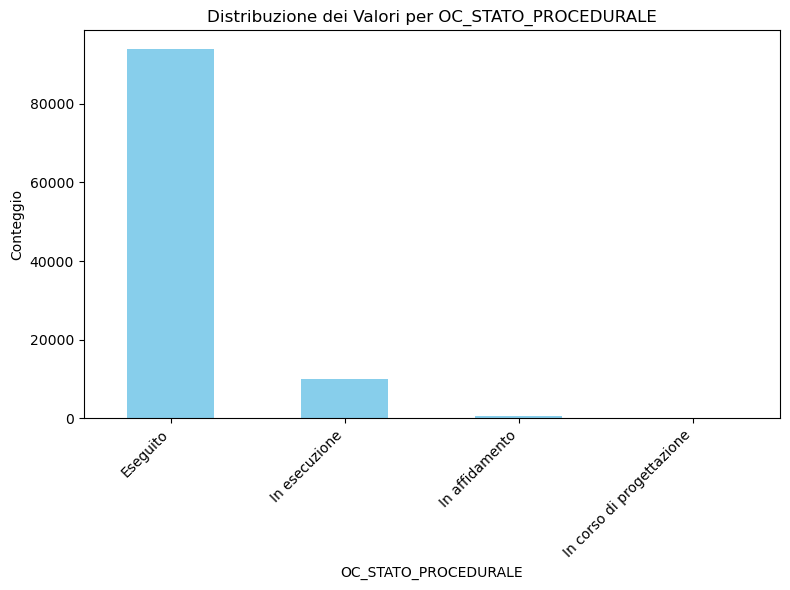

In [23]:
# Identificare le colonne che contengono "stato" nel nome
stato_columns = [col for col in df_lav.columns if 'oc_stato' in col.lower() ]
# Generare un grafico per ogni colonna identificata
for col in stato_columns:
    # Contare i valori unici in ciascuna colonna
    value_counts = df_lav[col].value_counts()
    
    # Creare un grafico a barre
    plt.figure(figsize=(8, 6))
    value_counts.plot(kind='bar', color='skyblue')
    plt.title(f'Distribuzione dei Valori per {col}')
    plt.xlabel(col)
    plt.ylabel('Conteggio')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

In [24]:
print(df_lav['OC_STATO_PROCEDURALE'].value_counts())
print(df_lav['OC_STATO_PROGETTO'].value_counts())
print(df_lav['OC_STATO_FINANZIARIO'].value_counts())

OC_STATO_PROCEDURALE
Eseguito                     93948
In esecuzione                10041
In affidamento                 596
In corso di progettazione       34
Name: count, dtype: int64
OC_STATO_PROGETTO
Concluso       79112
In corso       18834
Liquidato       6663
Non avviato       10
Name: count, dtype: int64
OC_STATO_FINANZIARIO
Liquidato      85775
In corso       18809
Non avviato       35
Name: count, dtype: int64


In [25]:
df_lav['delay'] = (df_lav['OC_DATA_FINE_PROGETTO_EFFETTIVA'] - df_lav['OC_DATA_FINE_PROGETTO_PREVISTA']).dt.days
df_lav['prj_duration_pred'] = (df_lav['OC_DATA_FINE_PROGETTO_PREVISTA'] - df_lav['OC_DATA_INIZIO_PROGETTO']).dt.days
df_lav['Perc_contrib_nok'] = (1-(df_lav['COSTO_RENDICONTABILE_UE']/df_lav['OC_FINANZ_TOT_PUB_NETTO']))

# Calcolare 'marginal_cost' gestendo la divisione per zero
df_lav['marginal_cost'] = np.where(
    df_lav['prj_duration_pred'] == 0,  # Condizione
    999999999,                        # Valore per divisione per zero
    df_lav['FINANZ_TOTALE_PUBBLICO'] / df_lav['prj_duration_pred']  # Valore normale
)
rows_to_drop = df_lav[df_lav['marginal_cost'] == 999999999]
df_lav = df_lav.drop(rows_to_drop.index)

In [26]:
# associate also a field with population of DEN_COMUNE or COD_COMUNE

In [27]:
df_lav['DEN_REGIONE_new'] = df_lav['DEN_REGIONE'].apply(lambda x: 'Multi' if ':::' in str(x) else x)
df_lav['DEN_PROVINCIA_new'] = df_lav['DEN_PROVINCIA'].apply(lambda x: 'Multi' if ':::' in str(x) else x)
df_lav['DEN_COMUNE_new'] = df_lav['DEN_COMUNE'].apply(lambda x: 'Multi' if ':::' in str(x) else x)

In [28]:
# Funzione per classificare il rischio
def classify_risk(row):
    Delay = row['delay']
    Perc_No_Ue = row['Perc_contrib_nok']
        
    # Logica per classificare il rischio
    if (
        Delay > 3650  or
        Perc_No_Ue >= 0.25
    ):
        return 3

    elif (
        Delay > 180  and Delay < 3650 or
        Perc_No_Ue >= 0.15 and Perc_No_Ue < 0.25
        
    ):
        return 2

    elif (
        Delay >= 60  and Delay < 180 or
        Perc_No_Ue >= 0.03 and Perc_No_Ue < 0.15
    ):
   
        return 1

    else:
        return 0

# Applicare la classificazione sul dataframe
df_lav['Risk'] = df_lav.apply(classify_risk, axis=1)

# Analisi della distribuzione del rischio
risk_distribution = df_lav['Risk'].value_counts()
print("Distribuzione dei rischi:")
print(risk_distribution)

# Analisi delle condizioni dei progetti ad alto rischio
#high_risk_stats = df_lav[df_lav['Rischio'] == 'Alto Rischio'].describe()
#print("\nStatistiche dei progetti ad Alto Rischio:")
#print(high_risk_stats)

import plotly.express as px

# Tabella interattiva
fig = px.scatter(df_lav, x='prj_duration_pred', y='marginal_cost', color='Risk',
                 hover_data=['OC_STATO_PROCEDURALE', 'OC_STATO_FINANZIARIO','OC_STATO_PROGETTO','COSTO_RENDICONTABILE_UE','delay','DEN_REGIONE_new'])
fig.show()

Distribuzione dei rischi:
Risk
0    78808
3    11638
2     8304
1     5618
Name: count, dtype: int64


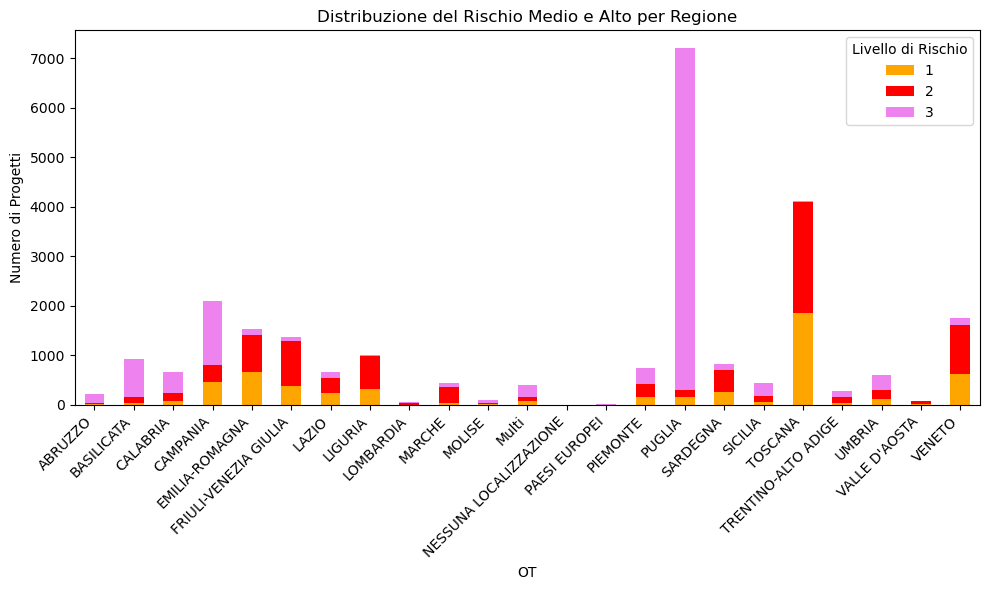

In [29]:
# Filtra i rischi "Medio" e "Alto"
filtered_df = df_lav[df_lav['Risk'].isin([3, 2, 1])]

# Raggruppa i dati per Regione e Rischio
risk_counts = filtered_df.groupby(['DEN_REGIONE_new', 'Risk']).size().unstack(fill_value=0)

# Visualizza il dataframe aggregato
#print(risk_counts)

# Creazione del grafico
risk_counts.plot(kind='bar', figsize=(10, 6), stacked=True, color=['orange', 'red','violet'])
plt.title('Distribuzione del Rischio Medio e Alto per Regione')
plt.xlabel('OT')
plt.ylabel('Numero di Progetti')
plt.legend(title='Livello di Rischio')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Mostra il grafico
plt.show()

### Model Creation
now we will find the right model

In [30]:
# as first step we go to select only features that we have at start of the project
df_lav1 = df_lav.copy()


# Seconda tabella con aggregazioni di variabili
tabella_aggregazioni = meta[['VARIABILE', 'SEZIONE']]

# Creare un dizionario dai primi 4 caratteri delle variabili della seconda tabella, con chiavi in lowercase
prefix_mapping = {
    row['VARIABILE'].lower(): row['SEZIONE'][:4]
    for _, row in tabella_aggregazioni.iterrows()
}

# Iterare sulle colonne della prima tabella e aggiungere prefisso se presente in mapping (ignorando il caso)
new_column_names = []
for col in df_lav.columns:
    col_lower = col.lower()  # Convertire il nome della colonna in lowercase
    if col_lower in prefix_mapping:
        # Aggiungere il prefisso
        new_name = f"{prefix_mapping[col_lower]}_{col}"
    else:
        # Mantenere il nome originale
        new_name = f"{'New'}_{col}"
    new_column_names.append(new_name)

# Rinominare le colonne nella prima tabella
df_lav1.columns = new_column_names

# Mostrare il risultato
#print(df_lav1)


In [31]:
df_lav1 = df_lav1.loc[:, ~df_lav1.columns.str.startswith("Fina")]
print(df_lav1)

       Anag_cod_locale_progetto         Anag_cup  \
0                    11FR103176  D59F20000220007   
1                    11FR103178  D89F20000420007   
2                    11FR103180  D69F20000220007   
3                    11FR103185  D89F20000450007   
4                    11FR103186  D59F20000240007   
...                         ...              ...   
104614               9UM8714215  I99I22000900009   
104615               9UM8714217  I99I22001070009   
104616               9UM8714218  I99I22000810009   
104617               9UM8714220  I99I22000910009   
104618               9UM8714221  I99I22000920009   

                                  Anag_oc_titolo_progetto  \
0          INFORMATIZZAZIONE E POTENZIAMENTO DEI PROCESSI   
1       PROST3SIS (PROGETTO OTTIMIZZAZIONE STAMPA 3D S...   
2                          FOOD SHELF LIFE MANAGEMENT 2.0   
3       INERTIZZAZIONE MATERIALI CONTENENTI AMIANTO TR...   
4       OLSIV - OFFICINA E LABORATORIO DI SISTEMI PER ...   
...      

In [32]:
col_names = df_lav1.columns

# Converte i nomi delle colonne in un DataFrame
col_names_df = pd.DataFrame(col_names)

# Salva i nomi delle colonne in un file Excel
col_names_df.to_excel('data_output\Col_names.xlsx', index=False, header=False)

## selezionare le features:

- per quelle che hanno primi 4 carattare Anag eliminare : Anag_cod_locale_progetto; Anag_oc_link
- per quelle che hanno primi 4 carattare Prog o Altr tenere solo quelli contenenti la stringa _COD_
- per quelle che hanno primi 4 carattare Terr tenere solo quelli che contengono stringa _DEN_
- per quelle che hanno primi 4 caratteri Temp o Avan o Proc o Indi o Flag o Aggi eliminare tutte
- per quelle che hanno primi 4 caratteri Sogg tenere solo Sogg_OC_DENOM_BENEFICIARIO; Sogg_OC_DESCR_FORMA_GIU_BENEFICIARIO
- per quelle che hanno primi 4 caratteri New_ tenere tutte 

In [33]:
df_lav1_originale = df_lav1 

In [34]:
# Copia del DataFrame originale per evitare modifiche in-place (opzionale)
df_lav1_originale = df_lav1.copy()

# 1. Per le colonne che iniziano con 'Anag', elimina specifiche colonne
df_lav1 = df_lav1.drop(columns=['Anag_cod_locale_progetto', 'Anag_oc_link'], errors='ignore')

# 2. Per le colonne che iniziano con 'Prog' o 'Altr', mantieni solo quelle che contengono '_COD_'
prog_altr_cols = df_lav1.columns[df_lav1.columns.str.startswith(('Prog', 'Altr'))]
cols_to_drop = prog_altr_cols[~prog_altr_cols.str.contains('_COD_')]
df_lav1 = df_lav1.drop(columns=cols_to_drop, errors='ignore')

# 3. Elimina tutte le colonne che iniziano con 'Temp', 'Avan', 'Proc', 'Indi', 'Flag', 'Aggi', 'Terr'
elim_prefixes = ('Temp', 'Avan', 'Proc', 'Indi', 'Flag', 'Aggi', 'Terr')
elim_cols = df_lav1.columns[df_lav1.columns.str.startswith(elim_prefixes)]
df_lav1 = df_lav1.drop(columns=elim_cols, errors='ignore')

# 4. Per le colonne che iniziano con 'Sogg', mantieni solo specifiche colonne
sogg_cols_to_keep = ['Sogg_OC_DENOM_BENEFICIARIO', 'Sogg_OC_DESCR_FORMA_GIU_BENEFICIARIO']
sogg_cols = df_lav1.columns[df_lav1.columns.str.startswith('Sogg')]
cols_to_drop = sogg_cols[~sogg_cols.isin(sogg_cols_to_keep)]
df_lav1 = df_lav1.drop(columns=cols_to_drop, errors='ignore')

# 5. Per le colonne che iniziano con 'New_', mantieni tutte (non serve azione)
# Non è necessaria alcuna operazione per queste colonne

# Visualizza il DataFrame aggiornato
print(df_lav1)

               Anag_cup                            Anag_oc_titolo_progetto  \
0       D59F20000220007     INFORMATIZZAZIONE E POTENZIAMENTO DEI PROCESSI   
1       D89F20000420007  PROST3SIS (PROGETTO OTTIMIZZAZIONE STAMPA 3D S...   
2       D69F20000220007                     FOOD SHELF LIFE MANAGEMENT 2.0   
3       D89F20000450007  INERTIZZAZIONE MATERIALI CONTENENTI AMIANTO TR...   
4       D59F20000240007  OLSIV - OFFICINA E LABORATORIO DI SISTEMI PER ...   
...                 ...                                                ...   
104614  I99I22000900009  CAMPAGNA DI COMUNICAZIONE AUTUNNO INVERNO 2022...   
104615  I99I22001070009     CAMPAGNA DI COMUNICAZIONE AUTUNNO INVERNO 2022   
104616  I99I22000810009  CAMPAGNA DI COMUNICAZIONE AUTUNNO INVERNO 2022...   
104617  I99I22000910009  CAMPAGNA DI COMUNICAZIONE AUTUNNO INVERNO 2022...   
104618  I99I22000920009  CAMPAGNA DI COMUNICAZIONE AUTUNNO INVERNO 2022...   

                                 Anag_oc_sintesi_progetto  Prog

# Data preparation

In [35]:
X = df_lav1.drop('New_Risk', axis=1)
y = df_lav1['New_Risk']

# Identifica i tipi di colonne (aggiorna con i tuoi nomi di colonne)
text_cols = ['Anag_oc_sintesi_progetto', 'Anag_oc_titolo_progetto']
numeric_cols = ['New_prj_duration_pred', 'New_Perc_contrib_nok', 'New_delay']
categorical_cols = list(set(X.columns) - set(text_cols) - set(numeric_cols))

## Pre-processing

In [36]:
text_transformers = ColumnTransformer(
    transformers=[
        ('text1', TfidfVectorizer(), 'Anag_oc_sintesi_progetto'),
        ('text2', TfidfVectorizer(), 'Anag_oc_titolo_progetto'),
    ],
    remainder='passthrough'  # Keep numeric and categorical data untouched
)

# Preprocessor for numeric and categorical data
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numeric_cols),
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_cols),
    ],
    remainder='drop'  # Drop columns not explicitly mentioned
)

# Combine preprocessing for numeric/categorical and text columns
final_preprocessor = ColumnTransformer(
    transformers=[
        ('num_cat', preprocessor, numeric_cols + categorical_cols),
        ('text', text_transformers, text_cols),
    ],
    remainder='drop'  # Drop other columns
)

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import classification_report, f1_score
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)

# Models and parameters
models = {
    "LogisticRegression": LogisticRegression(max_iter=500, multi_class="multinomial"),
    "KNN": KNeighborsClassifier(),
    "SVC": SVC(probability=True)
}

param_grids = {
    "LogisticRegression": {
        "classifier__C": [0.1, 1, 10],
        "classifier__penalty": ["l2"],
        "classifier__solver": ["lbfgs"],
    },
    "KNN": {
        "classifier__n_neighbors": [3, 5, 10],
        "classifier__weights": ["uniform", "distance"],
    },
    "SVC": {
        "classifier__C": [0.1, 1, 10],
        "classifier__kernel": ["rbf"],
        "classifier__gamma": ["scale"],
    }
}

# Store results
results = []

for model_name, model in models.items():
    # Create an ImbPipeline
    pipeline = ImbPipeline(
        steps=[
            ("preprocessor", final_preprocessor),
            ("smote", SMOTE(random_state=42)),  # Handle class imbalance
            ("classifier", model),
        ]
    )
    
    # Apply GridSearchCV
    grid_search = GridSearchCV(
        pipeline, param_grids[model_name], cv=5, scoring="f1_macro", n_jobs=-1
    )
    grid_search.fit(X_train, y_train)
    
    # Best model
    best_model = grid_search.best_estimator_
    
    # Predictions
    y_pred = best_model.predict(X_test)
    f1 = f1_score(y_test, y_pred, average="macro")  # Use 'macro' for multiclass
    
    # Store results
    results.append({"Model": model_name, "F1 Score": f1, "Best Params": grid_search.best_params_})

# Convert results to a sorted list based on F1 Score

C:\Users\gsepe\AppData\Roaming\Python\Python311\site-packages\sklearn\linear_model\_logistic.py:1247: FutureWarning:

'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.



In [ ]:
results.sort(key=lambda x: x["F1 Score"], reverse=True)

# Plot the results
model_names = [r["Model"] for r in results]
f1_scores = [r["F1 Score"] for r in results]

plt.barh(model_names, f1_scores)
plt.xlabel("F1 Score")
plt.title("Model Comparison (Multiclass with SMOTE)")
plt.gca().invert_yaxis()
plt.show()

# Display results with parameters
for result in results:
    print(f"Model: {result['Model']}")
    print(f"F1 Score: {result['F1 Score']:.4f}")
    print(f"Best Parameters: {result['Best Params']}")
    print("-" * 40)